<a href="https://colab.research.google.com/github/SAIGANESH02/Object-Detection-using-YOLO-V4/blob/main/Object_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Object Detection on Images/Videos/Webcam using Tensorflow-YoloV4

# Sai Ganesh

### Folders for model outputs and for saving the results 

In [ ]:
%mkdir outputs
%mkdir detections
%cd detections

C:\Users\Dell\Desktop\Python final Project\detections


In [ ]:
%mkdir videos
%mkdir images
%cd ..

C:\Users\Dell\Desktop\Python final Project


In [ ]:
%ls

 Volume in drive C has no label.
 Volume Serial Number is CAF4-12FC

 Directory of C:\Users\Dell\Desktop\Python final Project

12/08/2020  05:51 PM    <DIR>          .
12/08/2020  05:51 PM    <DIR>          ..
12/05/2020  10:03 PM    <DIR>          core
12/08/2020  05:13 PM    <DIR>          data
12/08/2020  05:51 PM    <DIR>          detections
12/08/2020  05:50 PM            47,133 Object Detection 076.ipynb
12/08/2020  05:51 PM    <DIR>          outputs
               1 File(s)         47,133 bytes
               6 Dir(s)  10,984,833,024 bytes free


### Changing to the YOLO-V4 Environment

In [ ]:
conda activate yolov4-gpu


Note: you may need to restart the kernel to use updated packages.


### This will print whether your tensorflow is using a CPU or a GPU backend. If you are running this command in jupyter notebook, check out the console from where you have launched the notebook. Your code will automatically run on GPU if any available GPU is detected.

In [ ]:
import tensorflow as tf
from tensorflow import keras
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
tf.test.is_built_with_cuda()
print(tf.version.VERSION)


Num GPUs Available:  1
2.3.0-rc0


In [ ]:
import sys
sys.version

'3.7.4 (default, Aug  9 2019, 18:34:13) [MSC v.1915 64 bit (AMD64)]'

### Requirements required for this project

#### Creating requirements-gpu.txt file for installing required packages

In [ ]:
%%writefile requirements-gpu.txt 
tensorflow-gpu==2.3.0rc0
opencv-python==4.1.1.26
lxml
tqdm
absl-py
matplotlib
easydict
pillow

Writing requirements-gpu.txt


In [ ]:
!pip install -r requirements-gpu.txt

# Convert darknet weights to tensorflow

### YOLOv4 comes pre-trained and able to detect 80 classes. We will use the pre-trained weights. Download pre-trained yolov4.weights file: https://drive.google.com/open?id=1cewMfusmPjYWbrnuJRuKhPMwRe_b9PaT. Copy and paste yolov4.weights from your downloads folder into this repository.

#### Creating save_model.py file for converting yolo-v4 weights into model for further execution

In [ ]:
%%writefile save_model.py

import tensorflow as tf
from absl import app, flags, logging
from absl.flags import FLAGS
from core.yolov4 import YOLO, decode, filter_boxes
import core.utils as utils
from core.config import cfg

flags.DEFINE_string('weights', './data/yolov4.weights', 'path to weights file')
flags.DEFINE_string('output', './checkpoints/yolov4-416', 'path to output')
flags.DEFINE_boolean('tiny', False, 'is yolo-tiny or not')
flags.DEFINE_integer('input_size', 416, 'define input size of export model')
flags.DEFINE_float('score_thres', 0.2, 'define score threshold')
flags.DEFINE_string('framework', 'tf', 'define what framework do you want to convert (tf, trt, tflite)')
flags.DEFINE_string('model', 'yolov4', 'yolov3 or yolov4')

def save_tf():
  STRIDES, ANCHORS, NUM_CLASS, XYSCALE = utils.load_config(FLAGS)

  input_layer = tf.keras.layers.Input([FLAGS.input_size, FLAGS.input_size, 3])
  feature_maps = YOLO(input_layer, NUM_CLASS, FLAGS.model, FLAGS.tiny)
  bbox_tensors = []
  prob_tensors = []
  if FLAGS.tiny:
    for i, fm in enumerate(feature_maps):
      if i == 0:
        output_tensors = decode(fm, FLAGS.input_size // 16, NUM_CLASS, STRIDES, ANCHORS, i, XYSCALE, FLAGS.framework)
      else:
        output_tensors = decode(fm, FLAGS.input_size // 32, NUM_CLASS, STRIDES, ANCHORS, i, XYSCALE, FLAGS.framework)
      bbox_tensors.append(output_tensors[0])
      prob_tensors.append(output_tensors[1])
  else:
    for i, fm in enumerate(feature_maps):
      if i == 0:
        output_tensors = decode(fm, FLAGS.input_size // 8, NUM_CLASS, STRIDES, ANCHORS, i, XYSCALE, FLAGS.framework)
      elif i == 1:
        output_tensors = decode(fm, FLAGS.input_size // 16, NUM_CLASS, STRIDES, ANCHORS, i, XYSCALE, FLAGS.framework)
      else:
        output_tensors = decode(fm, FLAGS.input_size // 32, NUM_CLASS, STRIDES, ANCHORS, i, XYSCALE, FLAGS.framework)
      bbox_tensors.append(output_tensors[0])
      prob_tensors.append(output_tensors[1])
  pred_bbox = tf.concat(bbox_tensors, axis=1)
  pred_prob = tf.concat(prob_tensors, axis=1)
  if FLAGS.framework == 'tflite':
    pred = (pred_bbox, pred_prob)
  else:
    boxes, pred_conf = filter_boxes(pred_bbox, pred_prob, score_threshold=FLAGS.score_thres, input_shape=tf.constant([FLAGS.input_size, FLAGS.input_size]))
    pred = tf.concat([boxes, pred_conf], axis=-1)
  model = tf.keras.Model(input_layer, pred)
  utils.load_weights(model, FLAGS.weights, FLAGS.model, FLAGS.tiny)
  model.summary()
  model.save(FLAGS.output)

def main(_argv):
  save_tf()

if __name__ == '__main__':
    try:
        app.run(main)
    except SystemExit:
        pass

Writing save_model.py


In [ ]:
!python save_model.py --weights yolov4.weights --output ./outputs/yolov4-416 --input_size 416 --model yolov4 

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 416, 416, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 416, 416, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
tf_op_layer_Softplus (TensorFlo [(None, 416, 416, 32 0           batch_normalization[0][0]        
_______________________________________________________________________________________

2020-12-08 18:11:07.878824: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:11:10.102329: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library nvcuda.dll
2020-12-08 18:11:11.221838: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 18:11:11.221902: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:11:11.231201: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 18:11:11.239915: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2

__________________________________________________________________________________________________
tf_op_layer_Tanh_2 (TensorFlowO [(None, 208, 208, 64 0           tf_op_layer_Softplus_2[0][0]     
__________________________________________________________________________________________________
tf_op_layer_Mul_6 (TensorFlowOp [(None, 208, 208, 64 0           batch_normalization_6[0][0]      
                                                                 tf_op_layer_Tanh_6[0][0]         
__________________________________________________________________________________________________
tf_op_layer_Mul_2 (TensorFlowOp [(None, 208, 208, 64 0           batch_normalization_2[0][0]      
                                                                 tf_op_layer_Tanh_2[0][0]         
__________________________________________________________________________________________________
tf_op_layer_concat (TensorFlowO [(None, 208, 208, 12 0           tf_op_layer_Mul_6[0][0]          
          

# Run yolov4 tensorflow model

#### Creating detect.py file for executing yolo-v4 tensorflow on images


In [ ]:
%%writefile detect.py

import tensorflow as tf
physical_devices = tf.config.experimental.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
from absl import app, flags, logging
from absl.flags import FLAGS
import core.utils as utils
from core.config import cfg
from core.yolov4 import filter_boxes
from tensorflow.python.saved_model import tag_constants
from PIL import Image
import cv2
import numpy as np
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

flags.DEFINE_string('framework', 'tf', '(tf, tflite, trt')
flags.DEFINE_string('weights', './checkpoints/yolov4-416',
                    'path to weights file')
flags.DEFINE_integer('size', 416, 'resize images to')
flags.DEFINE_boolean('tiny', False, 'yolo or yolo-tiny')
flags.DEFINE_string('model', 'yolov4', 'yolov3 or yolov4')
flags.DEFINE_list('images', './data/images/kite.jpg', 'path to input image')
flags.DEFINE_string('output', './detections/', 'path to output folder')
flags.DEFINE_float('iou', 0.45, 'iou threshold')
flags.DEFINE_float('score', 0.25, 'score threshold')
flags.DEFINE_boolean('dont_show', False, 'dont show image output')

def main(_argv):
    config = ConfigProto()
    config.gpu_options.allow_growth = True
    session = InteractiveSession(config=config)
    STRIDES, ANCHORS, NUM_CLASS, XYSCALE = utils.load_config(FLAGS)
    input_size = FLAGS.size
    images = FLAGS.images

    # load model
    if FLAGS.framework == 'tflite':
            interpreter = tf.lite.Interpreter(model_path=FLAGS.weights)
    else:
            saved_model_loaded = tf.saved_model.load(FLAGS.weights, tags=[tag_constants.SERVING])

    # loop through images in list and run Yolov4 model on each
    for count, image_path in enumerate(images, 1):
        original_image = cv2.imread(image_path)
        original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

        image_data = cv2.resize(original_image, (input_size, input_size))
        image_data = image_data / 255.

        images_data = []
        for i in range(1):
            images_data.append(image_data)
        images_data = np.asarray(images_data).astype(np.float32)

        if FLAGS.framework == 'tflite':
            interpreter.allocate_tensors()
            input_details = interpreter.get_input_details()
            output_details = interpreter.get_output_details()
            print(input_details)
            print(output_details)
            interpreter.set_tensor(input_details[0]['index'], images_data)
            interpreter.invoke()
            pred = [interpreter.get_tensor(output_details[i]['index']) for i in range(len(output_details))]
            if FLAGS.model == 'yolov3' and FLAGS.tiny == True:
                boxes, pred_conf = filter_boxes(pred[1], pred[0], score_threshold=0.25, input_shape=tf.constant([input_size, input_size]))
            else:
                boxes, pred_conf = filter_boxes(pred[0], pred[1], score_threshold=0.25, input_shape=tf.constant([input_size, input_size]))
        else:
            infer = saved_model_loaded.signatures['serving_default']
            batch_data = tf.constant(images_data)
            pred_bbox = infer(batch_data)
            for key, value in pred_bbox.items():
                boxes = value[:, :, 0:4]
                pred_conf = value[:, :, 4:]

        boxes, scores, classes, valid_detections = tf.image.combined_non_max_suppression(
            boxes=tf.reshape(boxes, (tf.shape(boxes)[0], -1, 1, 4)),
            scores=tf.reshape(
                pred_conf, (tf.shape(pred_conf)[0], -1, tf.shape(pred_conf)[-1])),
            max_output_size_per_class=50,
            max_total_size=50,
            iou_threshold=FLAGS.iou,
            score_threshold=FLAGS.score
        )
        pred_bbox = [boxes.numpy(), scores.numpy(), classes.numpy(), valid_detections.numpy()]

        # read in all class names from config
        class_names = utils.read_class_names(cfg.YOLO.CLASSES)

        # by default allow all classes in .names file
        allowed_classes = list(class_names.values())
        
        # custom allowed classes (uncomment line below to allow detections for only people)
        #allowed_classes = ['person']

        image = utils.draw_bbox(original_image, pred_bbox, allowed_classes = allowed_classes)

        image = Image.fromarray(image.astype(np.uint8))
        if not FLAGS.dont_show:
            image.show()
        image = cv2.cvtColor(np.array(image), cv2.COLOR_BGR2RGB)
        cv2.imwrite(FLAGS.output + 'detection' + str(count) + '.png', image)

if __name__ == '__main__':
    try:
        app.run(main)
    except SystemExit:
        pass


__________________________________________________________________________________________________
tf_op_layer_Tanh_18 (TensorFlow [(None, 52, 52, 128) 0           tf_op_layer_Softplus_18[0][0]    
__________________________________________________________________________________________________
tf_op_layer_Mul_36 (TensorFlowO [(None, 52, 52, 128) 0           batch_normalization_36[0][0]     
                                                                 tf_op_layer_Tanh_36[0][0]        
__________________________________________________________________________________________________
tf_op_layer_Mul_18 (TensorFlowO [(None, 52, 52, 128) 0           batch_normalization_18[0][0]     
                                                                 tf_op_layer_Tanh_18[0][0]        
__________________________________________________________________________________________________
tf_op_layer_concat_2 (TensorFlo [(None, 52, 52, 256) 0           tf_op_layer_Mul_36[0][0]         
         

## YOLO-V4 on Images

In [ ]:
!python detect.py --weights ./outputs/yolov4-416 --size 416 --model yolov4 --images ./data/images/kite.jpg --output ./detections/images/1

__________________________________________________________________________________________________
tf_op_layer_concat_7 (TensorFlo [(None, 52, 52, 256) 0           tf_op_layer_LeakyRelu_14[0][0]   
                                                                 tf_op_layer_ResizeBilinear_1[0][0
__________________________________________________________________________________________________
conv2d_87 (Conv2D)              (None, 52, 52, 128)  32768       tf_op_layer_concat_7[0][0]       
__________________________________________________________________________________________________
batch_normalization_87 (BatchNo (None, 52, 52, 128)  512         conv2d_87[0][0]                  
__________________________________________________________________________________________________
tf_op_layer_LeakyRelu_15 (Tenso [(None, 52, 52, 128) 0           batch_normalization_87[0][0]     
__________________________________________________________________________________________________
conv2d_88 

__________________________________________________________________________________________________
tf_op_layer_Sub_2 (TensorFlowOp [(None, 13, 13, 3, 2 0           tf_op_layer_Mul_80[0][0]         
__________________________________________________________________________________________________
tf_op_layer_Cast_2 (TensorFlowO [(None, 13, 13, 3, 2 0           tf_op_layer_Tile_2[0][0]         
__________________________________________________________________________________________________
tf_op_layer_AddV2_23 (TensorFlo [(None, 52, 52, 3, 2 0           tf_op_layer_Sub[0][0]            
                                                                 tf_op_layer_Cast[0][0]           
__________________________________________________________________________________________________
tf_op_layer_Exp (TensorFlowOpLa [(None, 52, 52, 3, 2 0           tf_op_layer_split[0][1]          
__________________________________________________________________________________________________
tf_op_laye

2020-12-08 18:12:36.086658: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:12:38.849070: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library nvcuda.dll
2020-12-08 18:12:39.386702: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 18:12:39.386764: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:12:39.398687: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 18:12:39.411387: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2

In [ ]:
!python detect.py --weights ./outputs/yolov4-416 --size 416 --model yolov4 --images ./data/images/test1.jpg --output ./detections/images/2

2020-12-08 18:13:19.239196: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:13:21.843347: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library nvcuda.dll
2020-12-08 18:13:22.105619: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 18:13:22.105652: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:13:22.113495: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 18:13:22.118708: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2

In [ ]:
!python detect.py --weights ./outputs/yolov4-416 --size 416 --model yolov4 --images ./data/images/test3.jpg --output ./detections/images/3

2020-12-08 18:14:00.722931: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:14:03.132156: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library nvcuda.dll
2020-12-08 18:14:03.642037: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 18:14:03.642074: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:14:03.650085: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 18:14:03.655632: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2

### This code helps to visualize the output in jupyter notebook or fast reference instead of running it locally

In [ ]:
# define helper functions
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(18, 10)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()

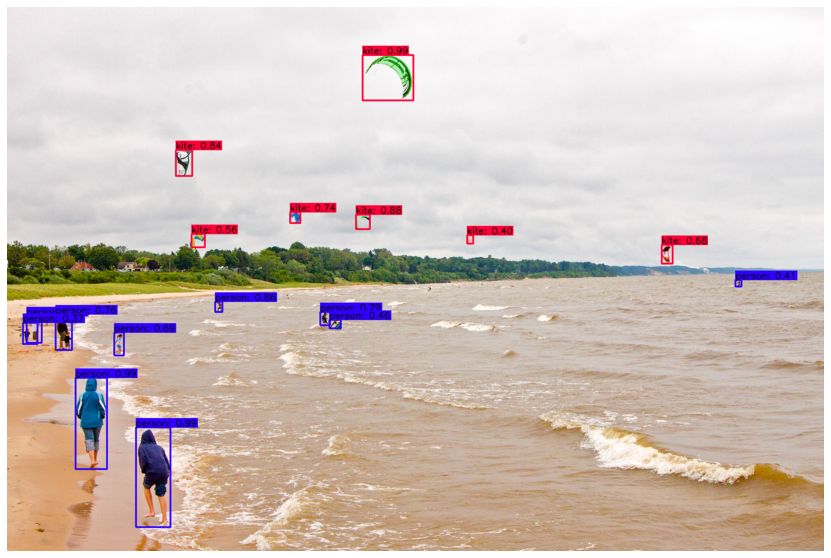

In [ ]:
imShow('./detections/images/1detection1.png')

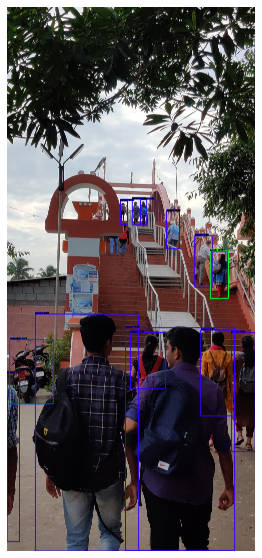

In [ ]:
imShow('./detections/images/2detection1.png')

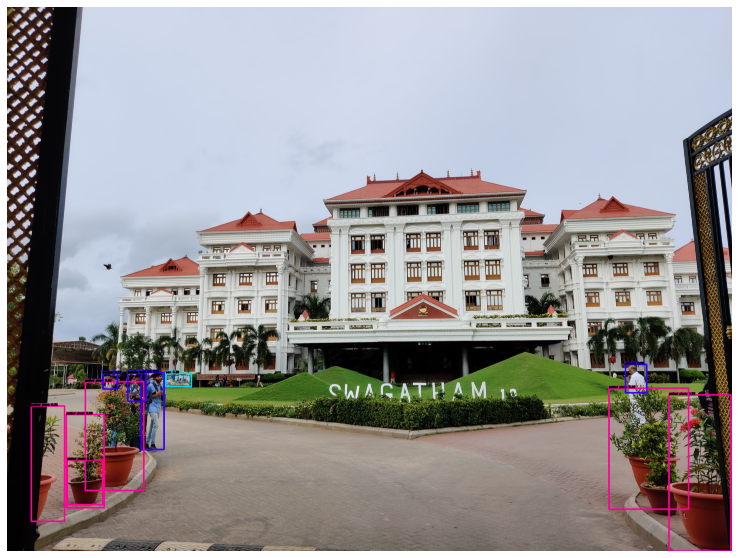

In [ ]:
imShow('./detections/images/3detection1.png')

## YOLO-V4 on Videos

#### Creating detect_video.py file for executing yolo-v4 tensorflow on videos

In [ ]:
%%writefile detect_video.py

import time
import tensorflow as tf
physical_devices = tf.config.experimental.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
from absl import app, flags, logging
from absl.flags import FLAGS
import core.utils as utils
from core.yolov4 import filter_boxes
from tensorflow.python.saved_model import tag_constants
from PIL import Image
import cv2
import numpy as np
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

flags.DEFINE_string('framework', 'tf', '(tf, tflite, trt')
flags.DEFINE_string('weights', './checkpoints/yolov4-416',
                    'path to weights file')
flags.DEFINE_integer('size', 416, 'resize images to')
flags.DEFINE_boolean('tiny', False, 'yolo or yolo-tiny')
flags.DEFINE_string('model', 'yolov4', 'yolov3 or yolov4')
flags.DEFINE_string('video', './data/video/video.mp4', 'path to input video or set to 0 for webcam')
flags.DEFINE_string('output', None, 'path to output video')
flags.DEFINE_string('output_format', 'XVID', 'codec used in VideoWriter when saving video to file')
flags.DEFINE_float('iou', 0.45, 'iou threshold')
flags.DEFINE_float('score', 0.25, 'score threshold')
flags.DEFINE_boolean('dont_show', False, 'dont show video output')

def main(_argv):
    config = ConfigProto()
    config.gpu_options.allow_growth = True
    session = InteractiveSession(config=config)
    STRIDES, ANCHORS, NUM_CLASS, XYSCALE = utils.load_config(FLAGS)
    input_size = FLAGS.size
    video_path = FLAGS.video

    if FLAGS.framework == 'tflite':
        interpreter = tf.lite.Interpreter(model_path=FLAGS.weights)
        interpreter.allocate_tensors()
        input_details = interpreter.get_input_details()
        output_details = interpreter.get_output_details()
        print(input_details)
        print(output_details)
    else:
        saved_model_loaded = tf.saved_model.load(FLAGS.weights, tags=[tag_constants.SERVING])
        infer = saved_model_loaded.signatures['serving_default']

    # begin video capture
    try:
        vid = cv2.VideoCapture(int(video_path))
    except:
        vid = cv2.VideoCapture(video_path)

    out = None

    if FLAGS.output:
        # by default VideoCapture returns float instead of int
        width = int(vid.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(vid.get(cv2.CAP_PROP_FRAME_HEIGHT))
        fps = int(vid.get(cv2.CAP_PROP_FPS))
        codec = cv2.VideoWriter_fourcc(*FLAGS.output_format)
        out = cv2.VideoWriter(FLAGS.output, codec, fps, (width, height))

    while True:
        return_value, frame = vid.read()
        if return_value:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            image = Image.fromarray(frame)
        else:
            print('Video has ended or failed, try a different video format!')
            break
    
        frame_size = frame.shape[:2]
        image_data = cv2.resize(frame, (input_size, input_size))
        image_data = image_data / 255.
        image_data = image_data[np.newaxis, ...].astype(np.float32)
        start_time = time.time()

        if FLAGS.framework == 'tflite':
            interpreter.set_tensor(input_details[0]['index'], image_data)
            interpreter.invoke()
            pred = [interpreter.get_tensor(output_details[i]['index']) for i in range(len(output_details))]
            if FLAGS.model == 'yolov3' and FLAGS.tiny == True:
                boxes, pred_conf = filter_boxes(pred[1], pred[0], score_threshold=0.25,
                                                input_shape=tf.constant([input_size, input_size]))
            else:
                boxes, pred_conf = filter_boxes(pred[0], pred[1], score_threshold=0.25,
                                                input_shape=tf.constant([input_size, input_size]))
        else:
            batch_data = tf.constant(image_data)
            pred_bbox = infer(batch_data)
            for key, value in pred_bbox.items():
                boxes = value[:, :, 0:4]
                pred_conf = value[:, :, 4:]

        boxes, scores, classes, valid_detections = tf.image.combined_non_max_suppression(
            boxes=tf.reshape(boxes, (tf.shape(boxes)[0], -1, 1, 4)),
            scores=tf.reshape(
                pred_conf, (tf.shape(pred_conf)[0], -1, tf.shape(pred_conf)[-1])),
            max_output_size_per_class=50,
            max_total_size=50,
            iou_threshold=FLAGS.iou,
            score_threshold=FLAGS.score
        )
        pred_bbox = [boxes.numpy(), scores.numpy(), classes.numpy(), valid_detections.numpy()]
        image = utils.draw_bbox(frame, pred_bbox)
        fps = 1.0 / (time.time() - start_time)
        print("FPS: %.2f" % fps)
        result = np.asarray(image)
        cv2.namedWindow("result", cv2.WINDOW_AUTOSIZE)
        result = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
        
        if not FLAGS.dont_show:
            cv2.imshow("result", result)
        
        if FLAGS.output:
            out.write(result)
        if cv2.waitKey(1) & 0xFF == ord('q'): break
    cv2.destroyAllWindows()

if __name__ == '__main__':
    try:
        app.run(main)
    except SystemExit:
        pass

Writing detect_video.py


In [ ]:
!python detect_video.py --weights ./outputs/yolov4-416 --size 416 --model yolov4 --video ./data/video/video.mp4 --output ./outputs/tracker.avi

FPS: 0.21

2020-12-08 18:15:11.744651: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:15:14.053911: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library nvcuda.dll
2020-12-08 18:15:14.160679: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 18:15:14.160744: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:15:14.169693: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 18:15:14.178055: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2


FPS: 12.30
FPS: 10.97
FPS: 9.87
FPS: 12.12
FPS: 12.38
FPS: 11.25
FPS: 12.09
FPS: 11.03
FPS: 11.04
FPS: 11.04
FPS: 11.02
FPS: 11.00
FPS: 12.12
FPS: 11.29
FPS: 12.17
FPS: 11.00
FPS: 11.02
FPS: 12.15
FPS: 12.35
FPS: 12.18
FPS: 10.65
FPS: 9.71
FPS: 11.32
FPS: 12.80
FPS: 11.82
FPS: 12.80
FPS: 11.00
FPS: 11.32
FPS: 12.38
FPS: 12.23
FPS: 11.00
FPS: 11.04
FPS: 11.30
FPS: 12.38
FPS: 11.27
FPS: 10.97
FPS: 11.05
FPS: 12.44
FPS: 12.40
FPS: 11.01
FPS: 9.84
FPS: 11.03
FPS: 12.30
FPS: 12.40
FPS: 12.37
FPS: 10.99
FPS: 11.28
FPS: 12.34
FPS: 12.25
FPS: 12.19
FPS: 10.99
FPS: 11.04
FPS: 11.29
FPS: 12.31
FPS: 11.26
FPS: 12.11
FPS: 11.10
FPS: 12.80
FPS: 12.80
FPS: 12.80
FPS: 12.05
FPS: 12.38
FPS: 11.27
FPS: 12.07
FPS: 12.43
FPS: 11.28
FPS: 12.39
FPS: 10.95
FPS: 11.00
FPS: 11.05
FPS: 12.35
FPS: 12.33
FPS: 11.02
FPS: 11.03
FPS: 11.12
FPS: 12.41
FPS: 11.27
FPS: 10.84
FPS: 11.91
FPS: 12.40
FPS: 12.40
FPS: 10.96
FPS: 12.05
FPS: 11.31
FPS: 12.42

2020-12-08 18:15:15.286406: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cusparse64_10.dll
2020-12-08 18:15:15.286420: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudnn64_7.dll
2020-12-08 18:15:15.286580: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1858] Adding visible gpu devices: 0
2020-12-08 18:15:15.286671: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1257] Device interconnect StreamExecutor with strength 1 edge matrix:
2020-12-08 18:15:15.286686: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1263]      0 
2020-12-08 18:15:15.286696: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1276] 0:   N 
2020-12-08 18:15:15.286810: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1402] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 2982 MB memory) -> physical GPU (device: 0, name: GeForce GTX 1050 Ti, pci bus id: 0000:01:00.0, com

In [ ]:
!python detect_video.py --weights ./outputs/yolov4-416 --size 416 --model yolov4 --video ./data/video/Test1.mp4 --output ./detections/videos/tracker.avi


FPS: 12.42
FPS: 10.78
FPS: 11.89
FPS: 11.31
FPS: 12.80
FPS: 11.82
FPS: 11.53
FPS: 12.10
FPS: 11.30
FPS: 12.36
FPS: 11.00
FPS: 11.71
FPS: 11.15
FPS: 12.27
FPS: 11.24
FPS: 12.06
FPS: 11.32
FPS: 12.37
FPS: 12.30
FPS: 10.92
FPS: 10.83
FPS: 11.31
FPS: 12.33
FPS: 12.37
FPS: 10.80
FPS: 11.29
FPS: 12.34
FPS: 11.23
FPS: 12.40
FPS: 11.29
FPS: 12.42
FPS: 11.05
FPS: 12.21
FPS: 11.03
FPS: 11.30
FPS: 12.34
FPS: 11.01
FPS: 10.99
FPS: 11.14
FPS: 12.35
FPS: 12.28
FPS: 11.27
FPS: 10.10
FPS: 11.27
FPS: 12.43
FPS: 12.29
FPS: 11.27
FPS: 11.24
FPS: 11.01
FPS: 11.26
FPS: 12.20
FPS: 11.13
FPS: 10.88
FPS: 10.07
FPS: 11.04
FPS: 11.03
FPS: 11.26
FPS: 11.01
FPS: 10.96
FPS: 10.11
FPS: 10.90
FPS: 11.01
FPS: 10.96
FPS: 10.04
FPS: 10.99
FPS: 11.04
FPS: 11.04
FPS: 11.00
FPS: 10.97
FPS: 10.82
FPS: 9.91
FPS: 10.78
FPS: 11.24
FPS: 11.82
FPS: 10.97
FPS: 10.98
FPS: 10.95
FPS: 11.02
FPS: 11.03
FPS: 12.01
FPS: 10.97
FPS: 10.08
FPS: 9.71
FPS: 11.03
FPS: 11.00
FPS: 10.94
FPS: 10.96
FPS: 10.94
FPS: 10.08
FPS: 9.91
FPS: 10.13
F

2020-12-08 18:16:25.734195: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:16:29.313183: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library nvcuda.dll
2020-12-08 18:16:29.816195: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 18:16:29.816262: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:16:29.825384: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 18:16:29.833845: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2


FPS: 11.04
FPS: 12.20
FPS: 10.90
FPS: 11.31
FPS: 11.03
FPS: 9.91
FPS: 11.03
FPS: 11.01
FPS: 11.90
FPS: 11.01
FPS: 12.42
FPS: 12.36
FPS: 10.87
FPS: 11.32
FPS: 11.03
FPS: 11.00
FPS: 11.06
FPS: 12.09
FPS: 12.36
FPS: 11.03
FPS: 11.04
FPS: 12.22
FPS: 10.78
FPS: 11.03
FPS: 10.99
FPS: 12.09
FPS: 11.04
FPS: 12.25
FPS: 9.86
FPS: 12.14
FPS: 12.31
FPS: 10.83
FPS: 12.42
FPS: 12.31
FPS: 11.27
FPS: 9.01
FPS: 12.41
FPS: 11.81
FPS: 8.88
FPS: 10.96
FPS: 11.02
FPS: 12.11
FPS: 10.54
FPS: 12.00
FPS: 10.76
FPS: 10.99
FPS: 12.43
FPS: 10.99
FPS: 9.89
FPS: 11.05
FPS: 11.95
FPS: 10.83
FPS: 12.41
FPS: 12.02
FPS: 11.08
FPS: 12.14
FPS: 12.32
FPS: 11.02
FPS: 11.04
FPS: 11.01
FPS: 12.08
FPS: 11.04
FPS: 12.13
FPS: 11.07
FPS: 11.00
FPS: 12.44
FPS: 11.23
FPS: 9.83
FPS: 11.30
FPS: 12.39
FPS: 10.93
FPS: 12.42
FPS: 12.41
FPS: 11.08
FPS: 11.02
FPS: 12.09
FPS: 12.37
FPS: 11.00
FPS: 11.03
FPS: 10.95
FPS: 10.99
FPS: 10.98
FPS: 12.36
FPS: 10.99
FPS: 10.13
FPS: 10.84
FPS: 10.63
FPS: 10.91
FPS: 11.02
FPS: 12.11
FPS: 10.76
FPS:

In [ ]:
!python detect_video.py --weights ./outputs/yolov4-416 --size 416 --model yolov4 --video ./data/video/road.mp4 --output ./detections/videos/tracker1.avi

FPS: 10.03
FPS: 10.03
FPS: 10.55
FPS: 10.55
FPS: 10.67
FPS: 10.78
FPS: 10.34
FPS: 10.78
FPS: 10.67
FPS: 10.34
FPS: 9.96
FPS: 10.67
FPS: 10.67
FPS: 10.90
FPS: 10.44
FPS: 10.41
FPS: 10.34
FPS: 10.67
FPS: 9.55
FPS: 10.44
FPS: 10.44
FPS: 10.44
FPS: 10.56
FPS: 9.93
FPS: 10.13
FPS: 10.55
FPS: 10.78
FPS: 10.64
FPS: 10.34
FPS: 10.88
FPS: 11.02
FPS: 10.67
FPS: 10.78
FPS: 10.44
FPS: 10.67
FPS: 10.10
Video has ended or failed, try a different video format!
FPS: 0.14
FPS: 10.44
FPS: 10.34
FPS: 10.34
FPS: 10.03
FPS: 10.67
FPS: 10.13
FPS: 10.67
FPS: 10.13
FPS: 10.90
FPS: 10.78
FPS: 10.45
FPS: 10.67
FPS: 10.55
FPS: 10.13
FPS: 10.90
FPS: 10.55
FPS: 10.44
FPS: 10.44
FPS: 10.44
FPS: 10.67
FPS: 11.14
FPS: 10.78
FPS: 10.78
FPS: 10.44
FPS: 10.90
FPS: 10.67
Video has ended or failed, try a different video format!


2020-12-08 18:18:39.235805: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:18:46.624311: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library nvcuda.dll
2020-12-08 18:18:47.391111: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 18:18:47.391218: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 18:18:47.414629: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 18:18:47.431026: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2

### This code helps to visualize the output in jupyter notebook or fast reference instead of running it locally

In [ ]:
# define helper function to display videos
import io 
from IPython.display import HTML
from base64 import b64encode
def show_video(file_name, width=640):
  # show resulting deepsort video
  mp4 = open(file_name,'rb').read()
  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
  return HTML("""
  <video width="{0}" controls>
        <source src="{1}" type="video/mp4">
  </video>
  """.format(width, data_url))

In [ ]:
# convert resulting video from avi to mp4 file format
import os
path_video = os.path.join("outputs","tracker.avi")
%cd outputs/
!ffmpeg -y -loglevel panic -i tracker.avi output.mp4
%cd ..

# output object tracking video
path_output = os.path.join("outputs","output.mp4")
show_video(path_output, width=960)

C:\Users\Dell\Desktop\Python final Project\outputs
C:\Users\Dell\Desktop\Python final Project


In [ ]:
# convert resulting video from avi to mp4 file format
import os
path_video = os.path.join("outputs","tracker.avi")
%cd detections\videos
!ffmpeg -y -loglevel panic -i tracker.avi output.mp4
%cd ..

# output object tracking video
path_output = os.path.join("videos","output.mp4")
show_video(path_output, width=960)

C:\Users\Dell\Desktop\Python final Project\detections\videos
C:\Users\Dell\Desktop\Python final Project\detections


In [ ]:
# convert resulting video from avi to mp4 file format
import os
path_video = os.path.join("outputs","tracker1.avi")
%cd detections\videos
!ffmpeg -y -loglevel panic -i tracker1.avi output1.mp4
%cd ..
%cd detections\ 
# output object tracking video
path_output = os.path.join("videos","output1.mp4")
show_video(path_output, width=960)

C:\Users\Dell\Desktop\Python final Project\detections\videos
C:\Users\Dell\Desktop\Python final Project\detections
[WinError 2] The system cannot find the file specified: 'detections\\'
C:\Users\Dell\Desktop\Python final Project\detections


## YOLO-V4 on WebCam

### Creating detect_video.py file for executing yolo-v4 tensorflow on WebCams

In [ ]:
%ls
%cd ..

 Volume in drive C has no label.
 Volume Serial Number is CAF4-12FC

 Directory of C:\Users\Dell\Desktop\Python final Project\detections

12/08/2020  05:51 PM    <DIR>          .
12/08/2020  05:51 PM    <DIR>          ..
12/08/2020  06:14 PM    <DIR>          images
12/08/2020  06:36 PM    <DIR>          videos
               0 File(s)              0 bytes
               4 Dir(s)  11,674,427,392 bytes free
C:\Users\Dell\Desktop\Python final Project


In [ ]:
 %ls

 Volume in drive C has no label.
 Volume Serial Number is CAF4-12FC

 Directory of C:\Users\Dell\Desktop\Python final Project

12/08/2020  06:20 PM    <DIR>          .
12/08/2020  06:20 PM    <DIR>          ..
12/08/2020  05:52 PM    <DIR>          .ipynb_checkpoints
12/05/2020  10:03 PM    <DIR>          core
12/08/2020  05:13 PM    <DIR>          data
12/08/2020  06:12 PM             4,814 detect.py
12/08/2020  06:15 PM             5,331 detect_video.py
12/08/2020  05:51 PM    <DIR>          detections
12/08/2020  06:20 PM        36,466,518 Object Detection 076.ipynb
12/08/2020  06:19 PM    <DIR>          outputs
12/08/2020  05:52 PM               102 requirements-gpu.txt
12/08/2020  05:52 PM             2,664 save_model.py
10/20/2020  11:14 PM       257,717,640 yolov4.weights
               6 File(s)    294,197,069 bytes
               7 Dir(s)  11,674,431,488 bytes free


In [ ]:
!python detect_video.py --weights ./outputs/yolov4-416 --size 416 --model yolov4 --video 0 

FPS: 0.11
FPS: 6.77
FPS: 10.34
FPS: 11.02
FPS: 11.39
FPS: 11.52
FPS: 11.52
FPS: 11.02


2020-12-08 20:55:24.655851: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 20:55:28.831149: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library nvcuda.dll
2020-12-08 20:55:29.298440: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 20:55:29.298487: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 20:55:29.332074: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 20:55:29.370803: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2

FPS: 9.20
FPS: 8.43
FPS: 9.73
FPS: 10.78
FPS: 11.47
FPS: 11.39
FPS: 11.52
FPS: 11.27
FPS: 10.03
FPS: 10.78
FPS: 11.02
FPS: 11.27
FPS: 11.39
FPS: 11.27
FPS: 11.14
FPS: 10.34
FPS: 10.44
FPS: 10.78
FPS: 11.14
FPS: 10.90
FPS: 11.14
FPS: 10.79
FPS: 10.44
FPS: 9.93
FPS: 10.44
FPS: 10.90
FPS: 11.02
FPS: 11.39
FPS: 11.52
FPS: 11.27
FPS: 9.37
FPS: 10.55
FPS: 10.55
FPS: 10.90
FPS: 11.27
FPS: 11.39
FPS: 11.27
FPS: 11.02
FPS: 10.78
FPS: 10.78
FPS: 10.78
FPS: 11.14
FPS: 11.52
FPS: 11.39
FPS: 11.14
FPS: 10.78
FPS: 10.44
FPS: 10.67
FPS: 10.90
FPS: 11.14
FPS: 11.39
FPS: 11.14
FPS: 11.02
FPS: 10.55
FPS: 10.78
FPS: 10.78
FPS: 11.02
FPS: 11.39
FPS: 11.39
FPS: 11.27
FPS: 10.78
FPS: 10.44
FPS: 10.78
FPS: 10.90
FPS: 11.39
FPS: 11.27
FPS: 11.39
FPS: 11.27
FPS: 10.90
FPS: 11.27
FPS: 11.39
FPS: 11.80
FPS: 11.66
FPS: 11.27
FPS: 11.02
FPS: 11.14
FPS: 11.66
FPS: 11.80
FPS: 11.66
FPS: 11.52
FPS: 11.02
FPS: 11.39
FPS: 11.80
FPS: 11.94
FPS: 11.66
FPS: 11.14
FPS: 11.14
FPS: 11.66
FPS: 11.94
FPS: 12.09
FPS: 11.27
FPS:

2020-12-08 20:55:31.372619: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): GeForce GTX 1050 Ti, Compute Capability 6.1
2020-12-08 20:55:31.517742: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 Ti computeCapability: 6.1
coreClock: 1.62GHz coreCount: 6 deviceMemorySize: 4.00GiB deviceMemoryBandwidth: 104.43GiB/s
2020-12-08 20:55:31.517801: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cudart64_101.dll
2020-12-08 20:55:31.517822: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cublas64_10.dll
2020-12-08 20:55:31.517837: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library cufft64_10.dll
2020-12-08 20:55:31.517850: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library curand


FPS: 11.02
FPS: 11.27
FPS: 11.94
FPS: 11.94
FPS: 11.94
FPS: 11.14
FPS: 11.14
FPS: 11.80
FPS: 11.80
FPS: 11.94
FPS: 11.39
FPS: 11.02
FPS: 11.52
FPS: 11.80
FPS: 11.79
FPS: 11.66
FPS: 11.14
FPS: 11.14
FPS: 11.66
FPS: 11.80
FPS: 11.66
FPS: 11.14
FPS: 11.80
FPS: 11.80
FPS: 11.94
FPS: 11.52
FPS: 10.90
FPS: 11.14
FPS: 11.66
FPS: 11.94
FPS: 11.94
FPS: 11.66
FPS: 11.02
FPS: 11.02
FPS: 11.66
FPS: 11.94
FPS: 12.08
FPS: 11.27
FPS: 11.14
FPS: 11.52
FPS: 11.80
FPS: 11.94
FPS: 11.52
FPS: 11.26
FPS: 10.97
FPS: 12.43
FPS: 10.67
FPS: 11.82
FPS: 11.83
FPS: 10.33
FPS: 12.73
FPS: 12.42
FPS: 11.94
FPS: 11.66
FPS: 10.78
FPS: 11.27
FPS: 11.52
FPS: 11.94
FPS: 11.80
FPS: 11.14
FPS: 10.55
FPS: 11.39
FPS: 11.80
FPS: 12.17
FPS: 12.30
FPS: 10.96
FPS: 10.97
FPS: 11.03
FPS: 11.03
FPS: 12.38
FPS: 11.35
FPS: 11.01
FPS: 10.15
FPS: 11.53
FPS: 11.80
FPS: 11.94
FPS: 11.80
FPS: 10.78
FPS: 10.90
FPS: 11.66
FPS: 11.82
FPS: 11.80
FPS: 11.53
FPS: 10.90
FPS: 11.27
FPS: 11.66
FPS: 11.80
FPS: 11.52
FPS: 11.39
FPS: 11.02
FPS: 11.3